In [1]:
from urllib.request import urlopen
from bs4 import BeautifulSoup
import pandas as pd
import re
import requests
import urllib
from urllib import request 
import ssl
import unidecode

In [2]:
import requests

url = "http://www.shipspotting.com/gallery/search.php?&search_title=&search_title_option=&search_imo=&search_pen_no=&search_mmsi=&search_eni=&search_callsign=&search_category_1=293&search_cat1childs=&search_uid=&search_country=&search_port=&search_subports=&search_flag=&search_homeport=&search_adminstatus=&search_classsociety=&search_builder=&search_buildyear1=&search_owner=&search_manager=&sortkey=p.lid&sortorder=desc&page_limit=12&viewtype=1&mod_page_limit=192"
headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/56.0.2924.76 Safari/537.36', "Upgrade-Insecure-Requests": "1","DNT": "1","Accept": "text/html,application/xhtml+xml,application/xml;q=0.9,*/*;q=0.8","Accept-Language": "en-US,en;q=0.5","Accept-Encoding": "gzip, deflate"}

response = requests.get(url, headers=headers)

ff = response.text.encode('utf8')
     
print (ff)

b'\n\t\t<!doctype html>\n\t\t<html lang="en" >\n\t\t<head>\n\t\t\t<title data-react-helmet="true"></title>\n\t\t\t\n\t\t\t<link rel="stylesheet" href="https://cdn.jsdelivr.net/npm/bootstrap@4.5.3/dist/css/bootstrap.min.css" integrity="sha384-TX8t27EcRE3e/ihU7zmQxVncDAy5uIKz4rEkgIXeMed4M0jlfIDPvg6uqKI2xXr2" crossorigin="anonymous">\n\t\t\t<link href="https://cdnjs.cloudflare.com/ajax/libs/font-awesome/5.15.3/css/fontawesome.min.css" rel="stylesheet" crossorigin="anonymous" />\n            <link data-react-helmet="true" rel="preload" href="/assets/images/header__logo.svg" as="image"/><link data-react-helmet="true" rel="preload" href="/assets/images/desktop/login__icon_hover.png" as="image"/><link data-react-helmet="true" rel="preload" href="/assets/images/desktop/uploaded_hover.png" as="image"/>\n\n\t\t\t<meta charset="UTF-8" />\n\t\t\t<meta name="viewport" content="width=device-width, user-scalable=no, initial-scale=1.0, maximum-scale=1.0, minimum-scale=1.0" />\n\t\t\t<meta httpEquiv="X

In [3]:
soup = BeautifulSoup(response.text.encode('utf8'), 'lxml')

In [13]:
content2 = soup.findAll('a')
content2

[<a class="HeaderTop__LogoContainer-sc-190dxdc-2 exfwPp logo-container" href="/"><img alt="ShipSpotting" src="/assets/images/header__logo.svg"/><div class="reg">®</div><div class="HeaderTop__HeaderTitle-sc-190dxdc-1 ivwNAo">SHIPSPOTTING.COM</div></a>,
 <a class="header__button header__button_upload">Upload</a>,
 <a class="header__button header__button_login">Login</a>,
 <a class="header__button header__button_register">Sign Up</a>,
 <a href="/" style="text-decoration:none !important"><img alt="ShipSpotting" src="/assets/images/header__logo.svg"/><div class="reg">®</div></a>,
 <a href="/"><div class="HeaderTop__HeaderTitle-sc-190dxdc-1 ivwNAo">SHIPSPOTTING.COM</div></a>,
 <a class="navbar1-menu__link" href="/videos">Videos</a>,
 <a class="navbar1-menu__link" href="//www.shipxplorer.com">ShipXplorer</a>,
 <a class="navbar1-menu__link" href="/support">Support</a>,
 <a class="navbar1-menu__link" href="/contact">Contact</a>,
 <a class="socials__link socials__link_fb" href="#"></a>,
 <a clas

In [7]:
tamanho = len (content2)
tamanho

1375

In [18]:
linkar=str(content2)
filtro1= linkar.split('"/></a>,')[3]
filtro1


' <a class="custom-link-color" href="/photos/gallery?imo=9936240">Emerald Putuo</a>, <a class="custom-link-color" href="/photos/gallery?user=5455">Marc Boucher</a>, <a class="custom-link-color" href="/photos/gallery?port=Quebec&amp;country=Canada">Quebec</a>, <a class="custom-link-color" href="/photos/gallery?country=Canada">Canada</a>, <a class="custom-link-color" href="/photos/gallery?category=293">Bulkers built 2021-2030</a>, <a class="custom-link-color" href="/photos/gallery?imo=9936240">9936240</a>, <a class="photo-card__link" href="/photos/3427199"><img class="photo-card__ship-photo" src="https://www.shipspotting.com/photos/middle/9/9/1/3427199.jpg'

In [104]:
content3 = soup.findAll('img')
content3
linkar=str(content3)
teste = linkar.replace("/small/","/big/")
teste



'[<img alt="ShipSpotting" src="/assets/images/header__logo.svg"/>, <img alt="ShipSpotting" src="/assets/images/header__logo.svg"/>, <img class="arrow" src="/assets/images/desktop/arrow.png"/>, <img class="arrow" src="/assets/images/desktop/arrow.png"/>, <img class="photo-card__ship-photo" src="https://www.shipspotting.com/photos/middle/7/7/2/3427277.jpg"/>, <img alt="like" src="/assets/images/desktop/most-popular/like.svg"/>, <img class="photo-card__ship-photo" src="https://www.shipspotting.com/photos/middle/6/7/2/3427276.jpg"/>, <img alt="like" src="/assets/images/desktop/most-popular/like.svg"/>, <img class="photo-card__ship-photo" src="https://www.shipspotting.com/photos/middle/1/0/2/3427201.jpg"/>, <img alt="like" src="/assets/images/desktop/most-popular/like.svg"/>, <img class="photo-card__ship-photo" src="https://www.shipspotting.com/photos/middle/9/9/1/3427199.jpg"/>, <img alt="like" src="/assets/images/desktop/most-popular/like.svg"/>, <img class="photo-card__ship-photo" src="h

# Extrair URL da  Imagem e ID

In [90]:
img =[]
codigo =[]
for i in range(150):
    if i > 0:
        filtro1= teste.split('photo" src="')[i]
        filtro2= filtro1.split('"/></a>,')[0]
        filtro3= filtro2.split('.jpg"/>, ')[0]
        filtro4=filtro3.split('/')[8]
        img.append(filtro3+".jpg")
        codigo.append(filtro4+".jpg")
codigo

['3427277.jpg',
 '3427276.jpg',
 '3427201.jpg',
 '3427199.jpg',
 '3427025.jpg',
 '3427024.jpg',
 '3427023.jpg',
 '3426510.jpg',
 '3426442.jpg',
 '3426171.jpg',
 '3426170.jpg',
 '3426113.jpg',
 '3426106.jpg',
 '3425914.jpg',
 '3425913.jpg',
 '3425912.jpg',
 '3425910.jpg',
 '3425141.jpg',
 '3425140.jpg',
 '3423735.jpg',
 '3423727.jpg',
 '3423726.jpg',
 '3423539.jpg',
 '3423538.jpg',
 '3423382.jpg',
 '3423381.jpg',
 '3423380.jpg',
 '3423379.jpg',
 '3423304.jpg',
 '3423299.jpg',
 '3423226.jpg',
 '3423217.jpg',
 '3423001.jpg',
 '3422988.jpg',
 '3422923.jpg',
 '3422597.jpg',
 '3422525.jpg',
 '3422524.jpg',
 '3422522.jpg',
 '3422520.jpg',
 '3422519.jpg',
 '3422477.jpg',
 '3422459.jpg',
 '3422290.jpg',
 '3422289.jpg',
 '3421729.jpg',
 '3421383.jpg',
 '3421172.jpg',
 '3420719.jpg',
 '3420718.jpg',
 '3420716.jpg',
 '3420208.jpg',
 '3419371.jpg',
 '3419348.jpg',
 '3419300.jpg',
 '3419063.jpg',
 '3418941.jpg',
 '3418938.jpg',
 '3418741.jpg',
 '3418740.jpg',
 '3418729.jpg',
 '3418728.jpg',
 '341872

# Visualizar

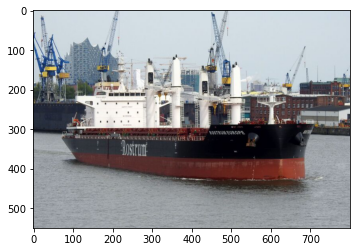

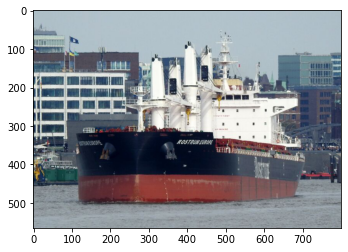

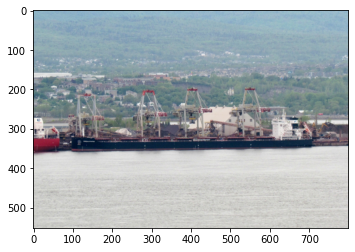

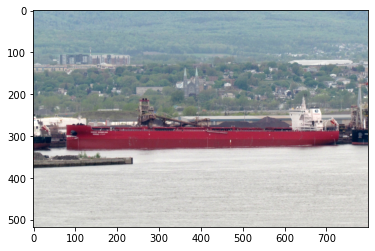

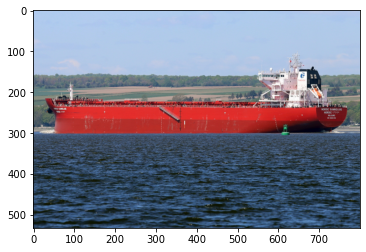

...

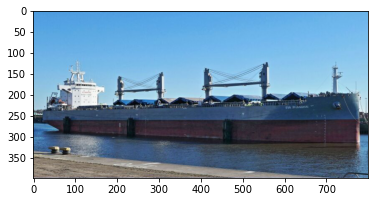

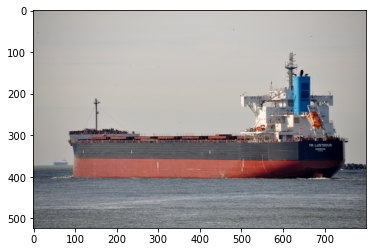

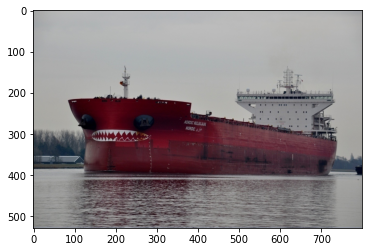

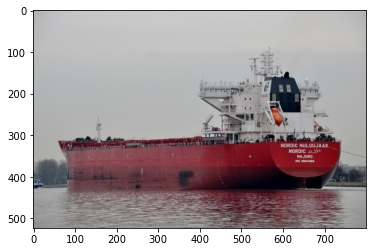

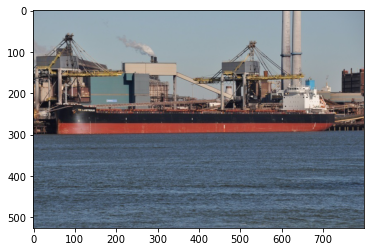

In [103]:
import requests, io
import matplotlib.pyplot as plt 
for z in range(len(img)):
    response = requests.get(img[z]).content
    imagens = plt.imread(io.BytesIO(response), format='JPG')
    plt.imshow(imagens)
    plt.show()


# Baixar

In [ ]:
import requests
for k in range(149):
    f = open(codigo[k],'wb')
    response = requests.get(img[k])
    f.write(response.content)
    f.close()

print("download successful")